# DIP Assignment 2

Arghya Roy (2021115008)


imports

In [137]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

import time

import math

from skimage.morphology import skeletonize


## 1. Let's Get Blurry

#### 1.1 Write a function `conv2D(img, kernel)` to convolve a 2D image with a 2D kernel of size k x k (Handle padding so that the resulting image is of the same size as input).


In [121]:
def conv2D(img, kernel):

    h, w, c = img.shape
    k, _ = kernel.shape
    pad = k // 2

    padded_img = np.pad(img, ((pad, pad), (pad, pad), (0, 0)), mode="constant", constant_values=0)
    new_img = np.zeros((h, w, c))

    for ch in range(c):
        for i in range(h):
            for j in range(w):
                region = padded_img[i : i + k, j : j + k, ch]
                new_img[i, j, ch] = np.sum(region * kernel)

    return new_img

#### 1.2 Apply a Mean Filter with default k=5 on IMG1 by writing a new function `meanFilter(img, k)` that takes in, a 2D image, kernel size, generates the appropriate kernel and filters the image using `conv2D()`

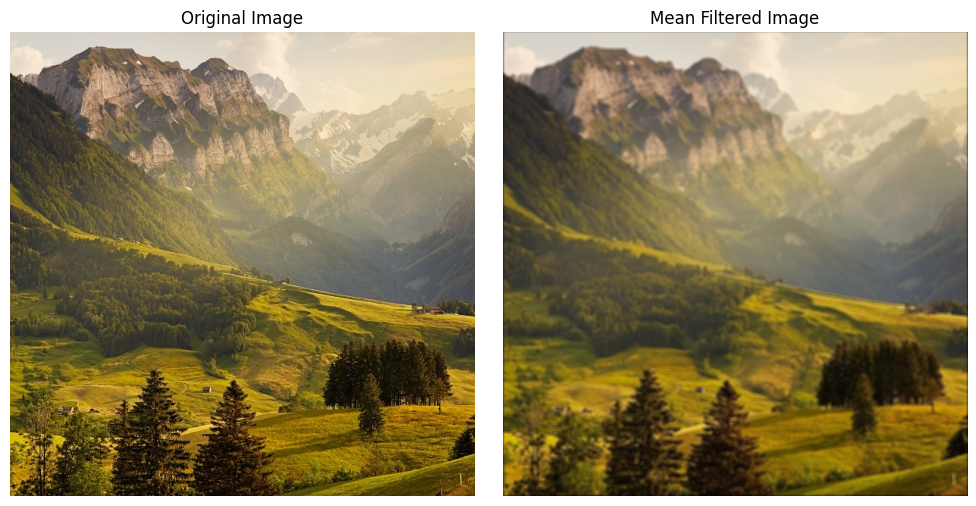

In [132]:
def meanFilter(img, k):
    kernel = np.ones((k, k)) / (k * k)
    return conv2D(img, kernel)


img1 = cv2.imread("../images/IMG1.jpg")
img1 = img1.astype(np.float32)

k=5
img1_meanFiltered = meanFilter(img1, k)

img1_rgb = cv2.cvtColor(img1.astype(np.uint8), cv2.COLOR_BGR2RGB)
img1_meanFiltered_rgb = cv2.cvtColor(img1_meanFiltered.astype(np.uint8), cv2.COLOR_BGR2RGB)

plt.figure(figsize=(10, 5))

plt.subplot(121)
plt.imshow(img1_rgb)
plt.title("Original Image")
plt.axis("off")

plt.subplot(122)
plt.imshow(img1_meanFiltered_rgb)
plt.title("Mean Filtered Image")
plt.axis("off")

plt.tight_layout()
plt.show()

#### 1.3 Similar to the above question, apply a Median Filter with default k=5 on IMG1 by writing a new function `medianFilter(img, k)` that takes in, a 2D image, kernel size, generates the appropriate kernel and filters the image using `conv2D()`.

In [133]:

def medianFilter(img, k):
    
    h, w, c = img.shape
    pad = k // 2

    padded_img = np.pad(img, ((pad, pad), (pad, pad), (0, 0)), mode="constant", constant_values=0)
    new_img = np.zeros((h, w, c))

    for ch in range(c):
        for i in range(h):
            for j in range(w):
                region = padded_img[i : i + k, j : j + k, ch]
                new_img[i, j, ch] = np.median(region)


    return new_img

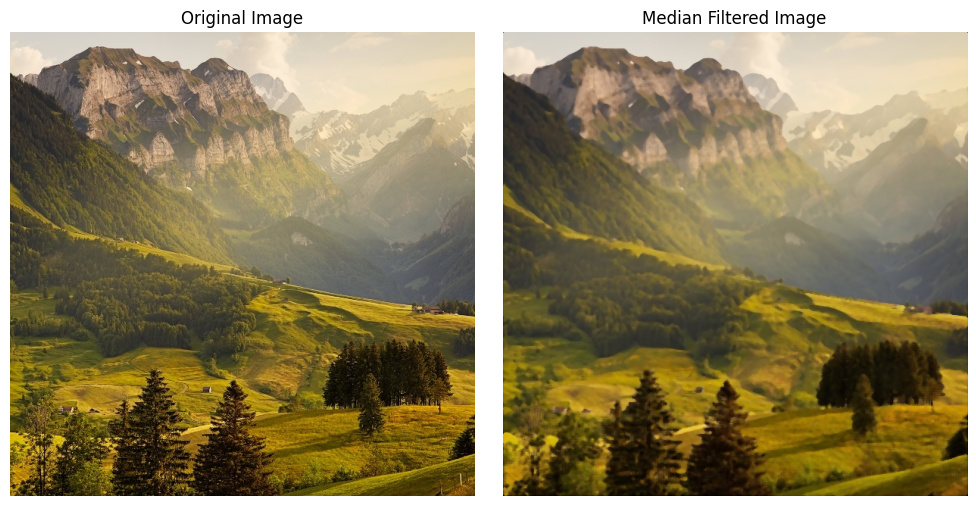

In [134]:
k=5
img1_medianFiltered = medianFilter(img1, k)
img1_medianFiltered_rgb = cv2.cvtColor(img1_medianFiltered.astype(np.uint8), cv2.COLOR_BGR2RGB)

plt.figure(figsize=(10, 5))
plt.subplot(121)
plt.imshow(img1_rgb)
plt.title("Original Image")
plt.axis("off")

plt.subplot(122)
plt.imshow(img1_medianFiltered_rgb)
plt.title("Median Filtered Image")
plt.axis("off")

plt.tight_layout()
plt.show()

#### 1.4 Make 2 plots for the time taken for the operations vs kernel size k(= any 3 values) for different image dimensions(=256x256, 512x512, 1024x1024) for IMG1 for both filters `meanFilter()` and `medianFilter()` . Comment on your observations.

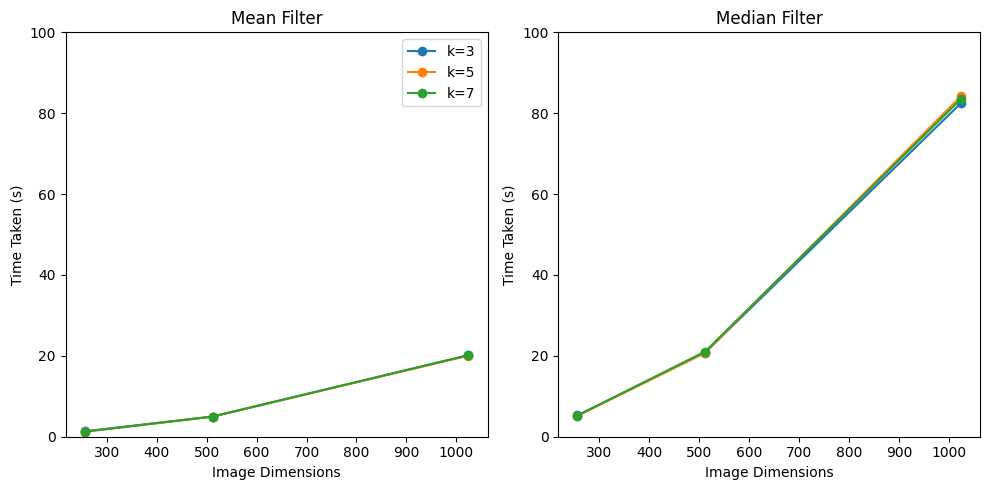

In [125]:
k_values = [3, 5, 7]
img_dims = [256, 512, 1024]

meanFilter_times = []
medianFilter_times = []

for k in k_values:
    meanFilter_time = []
    medianFilter_time = []

    for dim in img_dims:
        img=cv2.resize(img1, (dim, dim))
        img = img.astype(np.float32)

        start = time.time()
        meanFilter(img, k)
        meanFilter_time.append(time.time() - start)

        start = time.time()
        medianFilter(img, k)
        medianFilter_time.append(time.time() - start)

    meanFilter_times.append(meanFilter_time)
    medianFilter_times.append(medianFilter_time)

plt.figure(figsize=(10, 5))

plt.subplot(121)
plt.ylim([0,100])
plt.plot(img_dims, meanFilter_times[0], marker="o", label="k=3")
plt.plot(img_dims, meanFilter_times[1], marker="o", label="k=5")
plt.plot(img_dims, meanFilter_times[2], marker="o", label="k=7")
plt.xlabel("Image Dimensions")
plt.ylabel("Time Taken (s)")
plt.title("Mean Filter")
plt.legend()

plt.subplot(122)
plt.ylim([0,100])
plt.plot(img_dims, medianFilter_times[0], marker="o", label="k=3")
plt.plot(img_dims, medianFilter_times[1], marker="o", label="k=5")
plt.plot(img_dims, medianFilter_times[2], marker="o", label="k=7")
plt.xlabel("Image Dimensions")
plt.ylabel("Time Taken (s)")
plt.title("Median Filter")

plt.tight_layout()
plt.show()

Observations:

1. The time taken for the operations is more for median filter as compared to mean filter.
2. The time taken for the operations increases with the increase in image dimensions.
3. The time taken for the operations increases with the increase in kernel size.


#### 1.5 As the filter is moved from one location to the next, the filter window shares many common pixels in adjacent movements. On this note write a more efficient version, `fastMeanFilter(img, k)`. Make 2 plots comparing `meanFilter()` and `fastMeanFilter()` similar to plots in question 1.4. Comment on your observations

In [126]:

def fastMeanFilter_gray(img, k):
    h, w = img.shape
    pad = k // 2

    padded_img = np.pad(img, ((pad, pad), (pad, pad)), mode="constant", constant_values=0)
    new_img = np.zeros((h, w))

    k -= 1

    cumsum = np.cumsum(padded_img, axis=0)
    temp = cumsum[k:] - cumsum[:-k]
    cumsum = np.cumsum(temp, axis=1)
    new_img = (cumsum[:, k:] - cumsum[:, :-k]) / (k * k)

    return new_img

def fastMeanFilter(img, k):

    if len(img.shape) == 2:
        return fastMeanFilter_gray(img, k)

    h, w, c = img.shape

    pad = k // 2
    padded_img = np.pad(img, ((pad, pad), (pad, pad), (0, 0)), mode="constant", constant_values=0)
    new_img = np.zeros((h, w, c))

    k -= 1

    for channel in range(c):
        cumsum = np.cumsum(padded_img[:, :, channel], axis=0)
        temp = cumsum[k:] - cumsum[:-k]
        cumsum = np.cumsum(temp, axis=1)
        new_img[:, :, channel] = (cumsum[:, k:] - cumsum[:, :-k]) / (k * k)

    return new_img

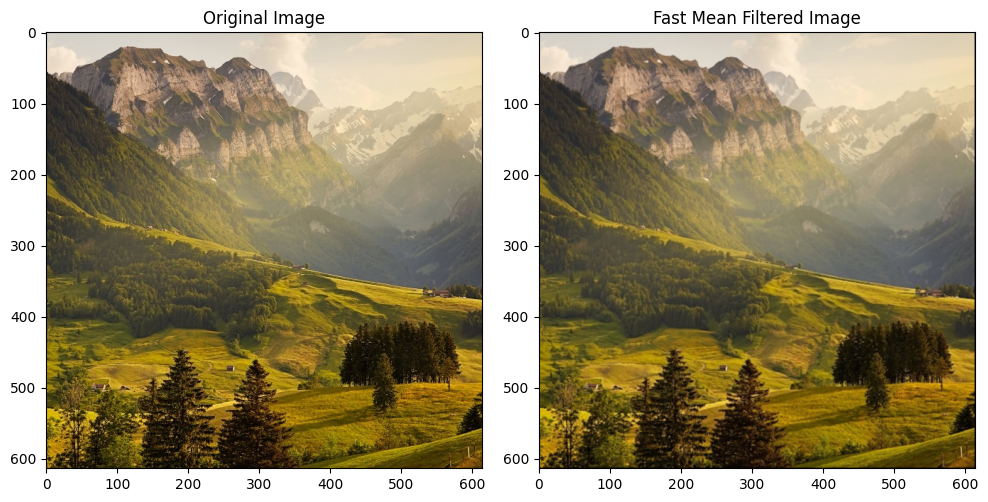

In [127]:
fastMeanFilterImg = fastMeanFilter(img1, 3)

fastMeanFilterImg_rgb = cv2.cvtColor(fastMeanFilterImg.astype(np.uint8), cv2.COLOR_BGR2RGB)

plt.figure(figsize=(10, 5))
plt.subplot(121)
plt.imshow(img1_rgb)
plt.title("Original Image")

plt.subplot(122)
plt.imshow(fastMeanFilterImg_rgb)
plt.title("Fast Mean Filtered Image")

plt.tight_layout()
plt.show()


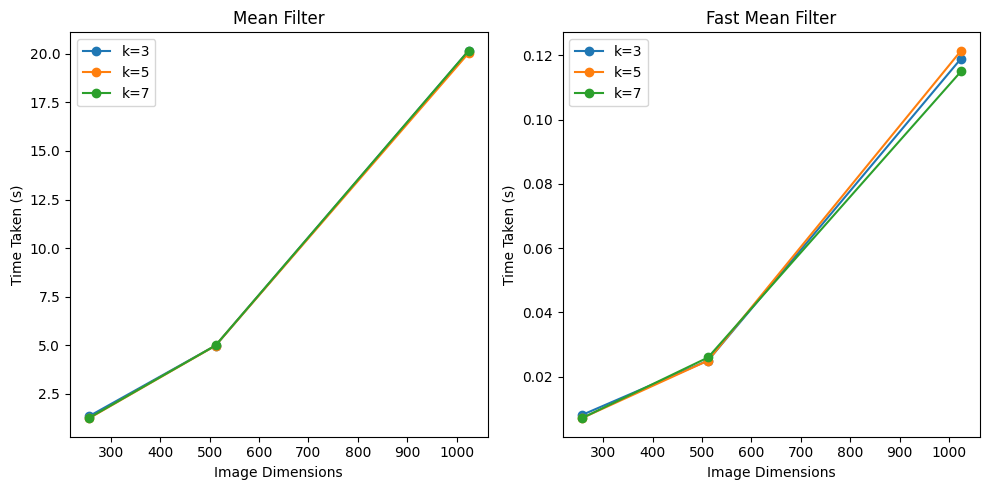

In [135]:
fastMeanFilter_times = []

for k in k_values:
    fastMeanFilter_time = []

    for dim in img_dims:
        img = cv2.resize(img1, (dim, dim))

        start = time.time()
        fastMeanFilter(img, k)
        fastMeanFilter_time.append(time.time() - start)

    fastMeanFilter_times.append(fastMeanFilter_time)


plt.figure(figsize=(10, 5))

plt.subplot(121)
plt.plot(img_dims, meanFilter_times[0], marker="o", label="k=3")
plt.plot(img_dims, meanFilter_times[1], marker="o", label="k=5")
plt.plot(img_dims, meanFilter_times[2], marker="o", label="k=7")
plt.xlabel("Image Dimensions")
plt.ylabel("Time Taken (s)")
plt.title("Mean Filter")
plt.legend()

plt.subplot(122)
plt.plot(img_dims, fastMeanFilter_times[0], marker="o", label="k=3")
plt.plot(img_dims, fastMeanFilter_times[1], marker="o", label="k=5")
plt.plot(img_dims, fastMeanFilter_times[2], marker="o", label="k=7")
plt.xlabel("Image Dimensions")
plt.ylabel("Time Taken (s)")
plt.title("Fast Mean Filter")
plt.legend()

plt.tight_layout()
plt.show()

Observation:

The time taken for the operations is less for fast mean filter as compared to mean filter.


---

## 2. Distribution is the Solution

#### 2.1 Apply Gaussian Filter with default k=7 on `IMG2` by writing a new function `gaussFilter(img, k, σ)` that takes in, a 2D image, kernel size, $\sigma$ and generates the appropriate kernel and filters the image using `conv2D()`.

In [129]:
def gaussianFilter(img, k, sigma):
    pad = k // 2

    kernel = np.zeros((k, k))
    for i in range(k):
        for j in range(k):
            kernel[i, j] = np.exp(-((i - pad) ** 2 + (j - pad) ** 2) / (2 * sigma ** 2))

    kernel /= np.sum(kernel)

    return conv2D(img, kernel), kernel

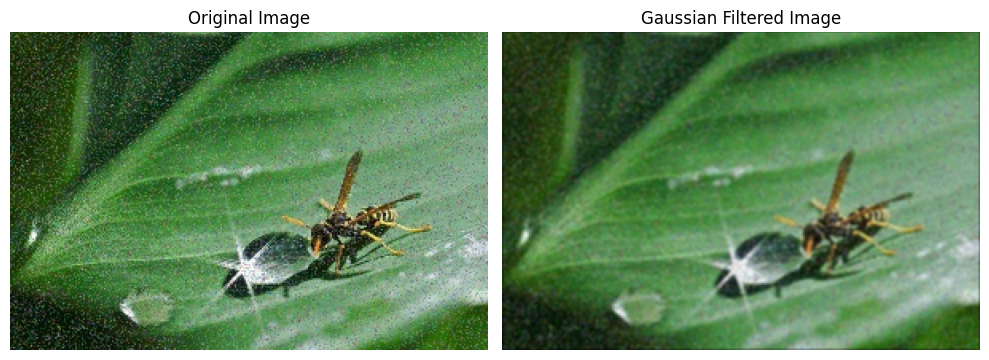

In [130]:
img2 = cv2.imread("../images/IMG2.jpg")

img2 = img2.astype(np.float32)

img2_gaussianFiltered, kernel = gaussianFilter(img2, 3, 1)

img2_rgb = cv2.cvtColor(img2.astype(np.uint8), cv2.COLOR_BGR2RGB)

img2_gaussianFiltered_rgb = cv2.cvtColor(img2_gaussianFiltered.astype(np.uint8), cv2.COLOR_BGR2RGB)

plt.figure(figsize=(10, 5))

plt.subplot(121)
plt.imshow(img2_rgb)
plt.title("Original Image")
plt.axis("off")

plt.subplot(122)
plt.imshow(img2_gaussianFiltered_rgb)
plt.title("Gaussian Filtered Image")
plt.axis("off")

plt.tight_layout()
plt.show()


#### 2.2 Display the results by trying few different values of σ (standard deviation) and find the optimal σ value for k=7, and show the plot which proves so. 
Hint: You can verify that most of the gaussian distribution’s area (around 99%) is included within the kernel distribution.

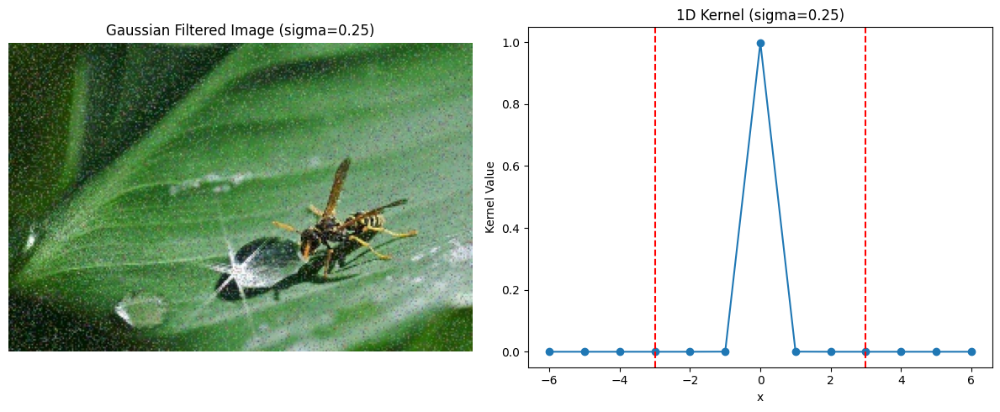

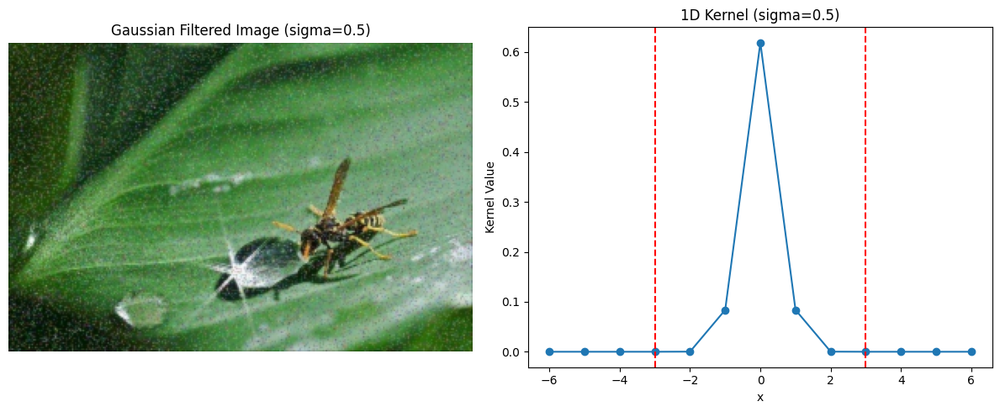

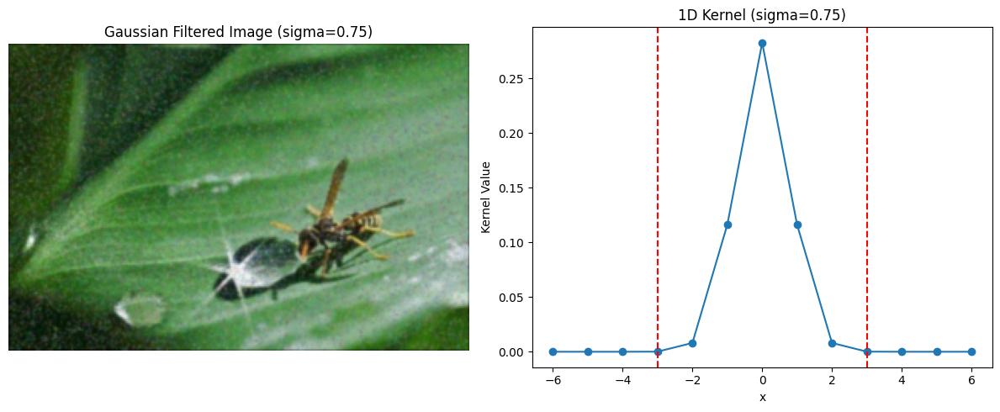

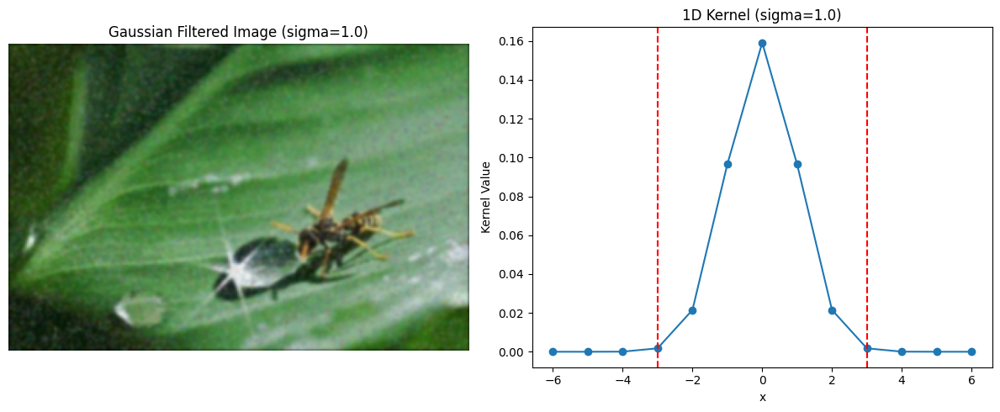

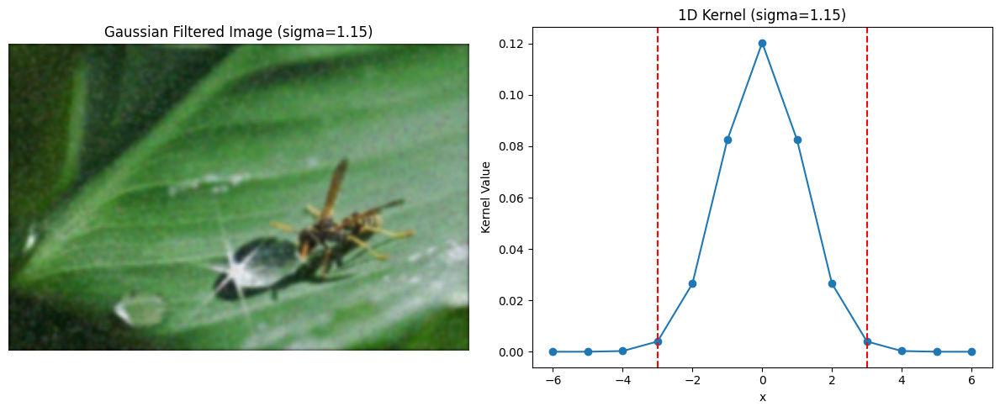

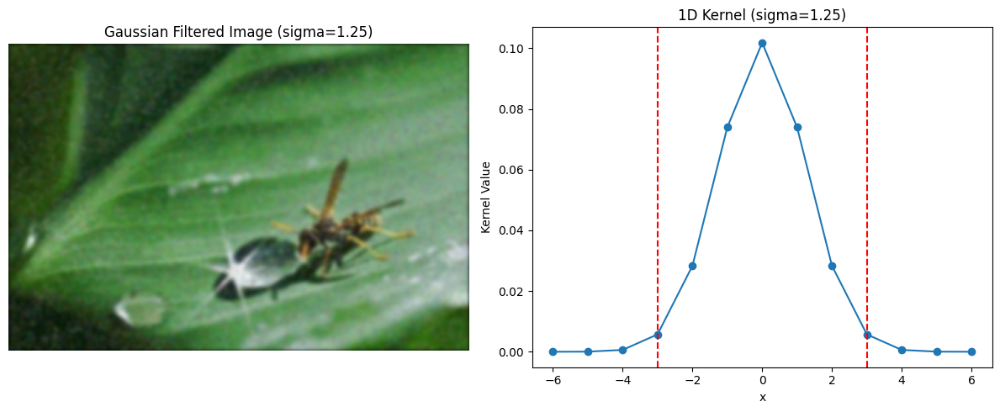

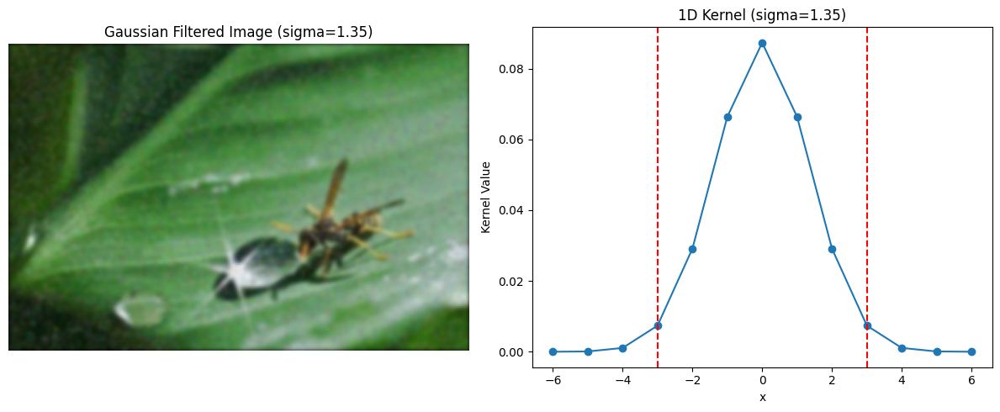

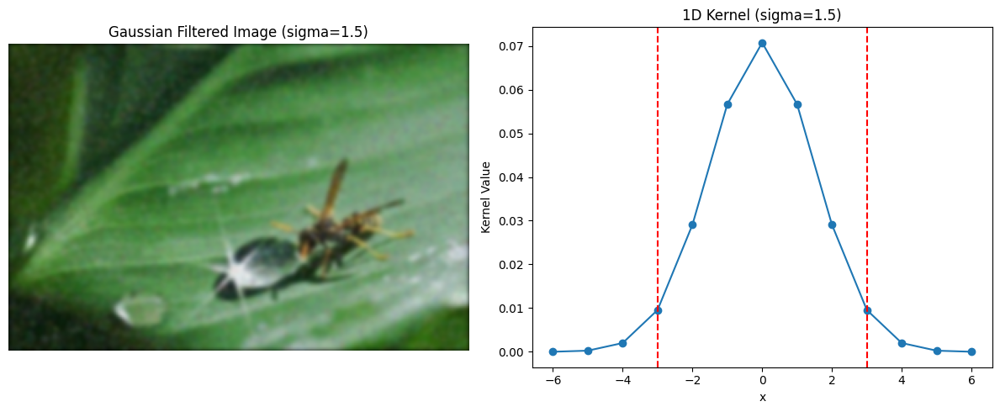

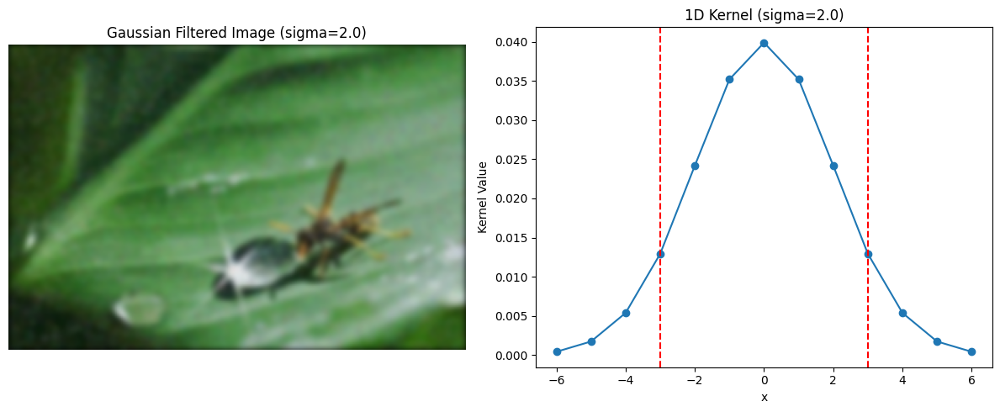

In [151]:
# def kernel_cumulative_percentage(kernel):
#     kernel_flat = kernel.flatten()
#     kernel_sorted = np.sort(kernel_flat)[::-1]  # descending order
#     kernel_cumsum = np.cumsum(kernel_sorted)
    
#     kernel_cumsum /= kernel_cumsum[-1]
    
#     return kernel_cumsum

k = 13
sigma_values = [0.25, 0.5, 0.75, 1.0, 1.15, 1.25, 1.35, 1.5, 2.0]

for sigma in sigma_values:
    img2_gaussianFiltered, kernel = gaussianFilter(img2, k, sigma)
    img2_gaussianFiltered_rgb = cv2.cvtColor(img2_gaussianFiltered.astype(np.uint8), cv2.COLOR_BGR2RGB)

    # kernel_cumsum = kernel_cumulative_percentage(kernel)
    # kernel_size = kernel.shape[0]

    plt.figure(figsize=(12, 5))

    # plt.subplot(131)
    plt.subplot(121)
    plt.imshow(img2_gaussianFiltered_rgb)
    plt.title(f"Gaussian Filtered Image (sigma={sigma})")
    plt.axis("off")

    # plt.subplot(132)
    plt.subplot(122)
    plt.plot(range(math.ceil(-k / 2), k // 2 + 1), kernel[k // 2, :], marker='o')
    plt.axvline(x=3, color='r', linestyle='--')
    plt.axvline(x=-3, color='r', linestyle='--')
    plt.title(f"1D Kernel (sigma={sigma})")
    plt.xlabel("x")
    plt.ylabel("Kernel Value")

    # plt.subplot(133)
    # plt.plot(np.arange(1, len(kernel_cumsum) + 1), kernel_cumsum * 100)
    # plt.axhline(y=99, color='r', linestyle='--', label='99%')
    # plt.title("Cumulative Kernel Distribution")
    # plt.xlabel("Sorted Kernel Elements")
    # plt.ylabel("Cumulative Percentage (%)")
    # plt.yscale("log")
    # plt.legend()

    plt.tight_layout()
    plt.show()

From observation, $\sigma = 1.15$ seems to be the optimal value for $k=7$, based on the plot as most of the gaussian distribution's area (around 99%) is included within the kernel distribution.

#### 2.3 Now vary kernel(k=any 3 values) sizes (keep σ as the above found optimal value) and display results. Comment on your observations of how the function is affected by changing values of k and σ.

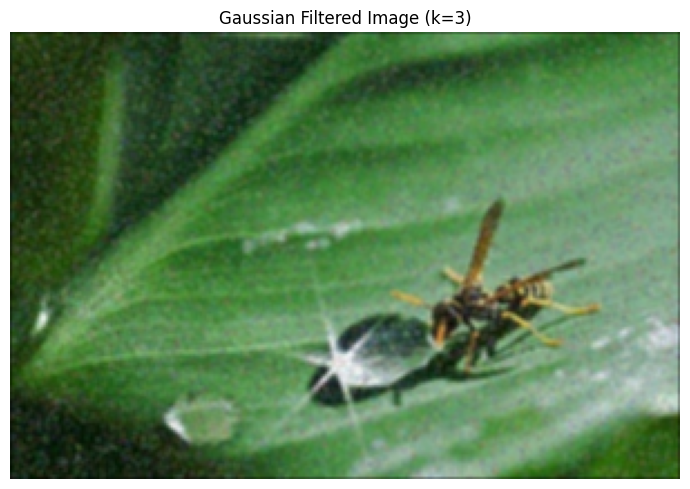

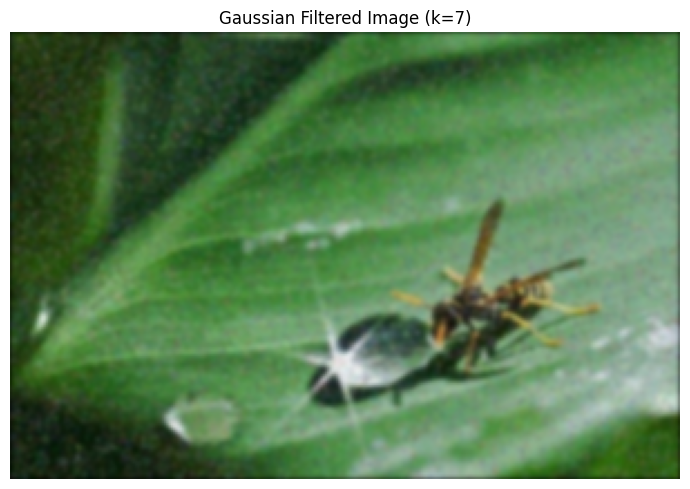

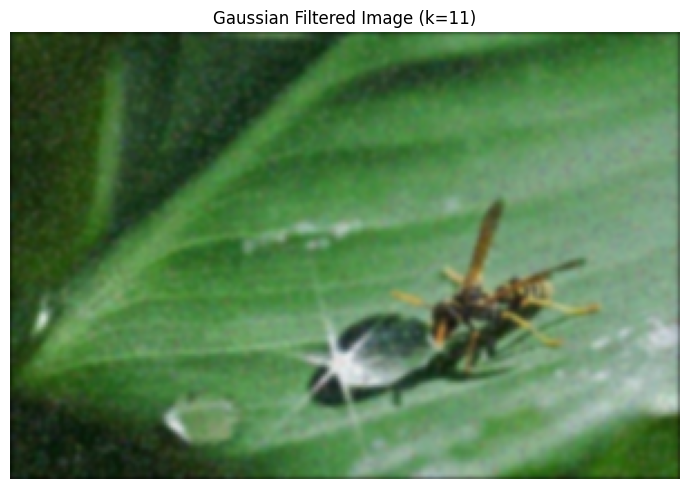

In [153]:
sigma_optimal = 1.15
k_values = [3, 7, 11]

for k in k_values:
    img2_gaussianFiltered, _ = gaussianFilter(img2, k, sigma_optimal)
    img2_gaussianFiltered_rgb = cv2.cvtColor(img2_gaussianFiltered.astype(np.uint8), cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(7, 7))
    plt.imshow(img2_gaussianFiltered_rgb)
    plt.title(f"Gaussian Filtered Image (k={k})")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

Observations

The image is more blurred with the increase in kernel size from 3 to 7, but the image is not really signifcantly affected with the increase in kernel size from 7 to 11. This is because, as we have seen in the plot, most of the gaussian distribution's area (around 99%) is included within the kernel distribution for $\sigma = 1.15$ and $k=7$. So, the image is not really affected with the increase in kernel size from 7 to 11 as most of the other values are close to 0.

#### 2.4 Apply Bilateral Filter with default `k=7` on IMG2 by writing a new function `bilaterFilter(img, k, σs, σr)` that takes in, a 2D image, kernel size, $\sigma_s$ (standard deviation for spatial gaussian) , σr $\sigma_r$ (standard deviation for intensity range gaussian) and generates the appropriate kernel and filters the image using `conv2D()`

In [82]:
def bilateralFilter(img, k, sigma_s, sigma_r):
    pad = k // 2
    img_padded = np.pad(img, ((pad, pad), (pad, pad), (0, 0)), mode='constant')
    img_filtered = np.zeros_like(img, dtype=np.float64)
    
    x, y = np.mgrid[-pad:pad+1, -pad:pad+1]
    spatial_term = np.exp(-(x**2 + y**2) / (2 * sigma_s**2))
    
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            roi = img_padded[i:i+k, j:j+k]
            
            intensity_diff = roi - img[i, j]
            intensity_term = np.exp(-(np.sum(intensity_diff**2, axis=2)) / (2 * sigma_r**2))
            
            w = spatial_term * intensity_term
            w /= np.sum(w)
            
            for c in range(img.shape[2]):
                img_filtered[i, j, c] = np.sum(w * roi[:, :, c])
    
    return img_filtered.astype(np.uint8)

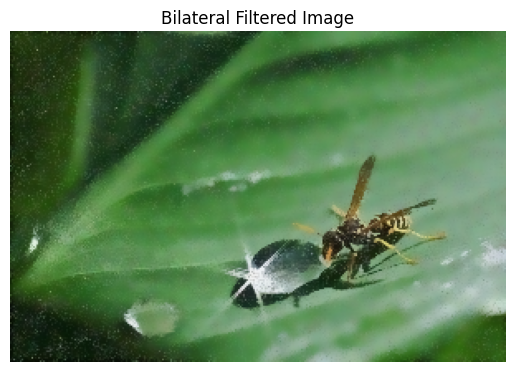

In [40]:
k = 7  
sigma_s = 15
sigma_r = 50

img2_filtered = bilateralFilter(img2, k, sigma_s, sigma_r)

img2_filtered_rgb = cv2.cvtColor(img2_filtered, cv2.COLOR_BGR2RGB)
plt.imshow(img2_filtered_rgb)
plt.axis("off")
plt.title("Bilateral Filtered Image")
plt.show()


#### 2.5 Apply `bilaterFilter()` on IMG2 with different values of `k`, $\sigma_s$ and $\sigma_r$ show how they affect the outcome by changing one parameter at a time. Comment on your observations

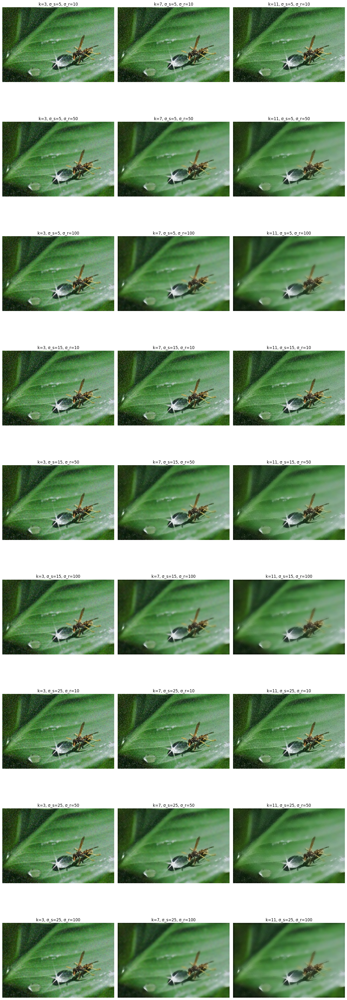

In [43]:
k_values = [3, 7, 11]
sigma_s_values = [5, 15, 25]
sigma_r_values = [10, 50, 100]

nrows = len(sigma_s_values) * len(sigma_r_values) 
ncols = len(k_values)

plt.figure(figsize=(15, nrows * 5))
subplot_idx = 1

for sigma_s in sigma_s_values:
    for sigma_r in sigma_r_values:
        for k in k_values:
            img2_filtered = bilateralFilter(img2, k, sigma_s, sigma_r)
            img2_filtered_rgb = cv2.cvtColor(img2_filtered, cv2.COLOR_BGR2RGB)
            
            plt.subplot(nrows, ncols, subplot_idx)
            plt.imshow(img2_filtered_rgb)
            plt.axis("off")
            plt.title(f"k={k}, σ_s={sigma_s}, σ_r={sigma_r}")
            
            subplot_idx += 1

plt.tight_layout()
plt.show()


Observations

- The bilateral filter seems to be a powerful tool for denoising while preserving edges, and the choice of parameters depends on the desired trade-off between noise reduction and detail preservation.

- As the kernel size $k$, spatial standard deviation $\sigma_s$, and range standard deviation $\sigma_r$ increase, the image becomes progressively smoother. However, the degree of edge preservation decreases slightly, and high-frequency texture details may be lost.

- The bilateral filter is known for edge preservation, and this is evident even as the parameters change. However, very large values of $k$ and $\sigma_r$ can blur the edges slightly, while still maintaining the main contours of the image.

- Small values of $\sigma_s$ and $\sigma_r$ retain fine textures, but as these values increase, finer details become blurred, especially in homogeneous regions like the leaf’s surface. Noise is reduced more effectively with larger parameter values, but the trade-off is a loss of detail.


#### 2.6 Comment on the difference between the results of gaussian and bilateral filters.

---

## 3. Edge of Glory

#### 3.1 Apply a Sobel filter on IMG3 by writing a function `sobelFilter(img)` that takes in a 2D image, applies the Sobel filter (for both horizontal and vertical edges), and combines the results to get the magnitude of the gradient.

In [10]:
def sobelFilterX(img):
    kernel = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])
    res = conv2D(img, kernel)
    return np.clip(res, 0, 255)


def sobelFilterY(img):
    kernel = np.array([[-1, -2, -1], [0, 0, 0], [1, 2, 1]])
    res = conv2D(img, kernel)
    return np.clip(res, 0, 255)


def sobelFilter(img):
    img_sobelX = sobelFilterX(img)
    img_sobelY = sobelFilterY(img)

    return np.sqrt(img_sobelX**2 + img_sobelY**2)

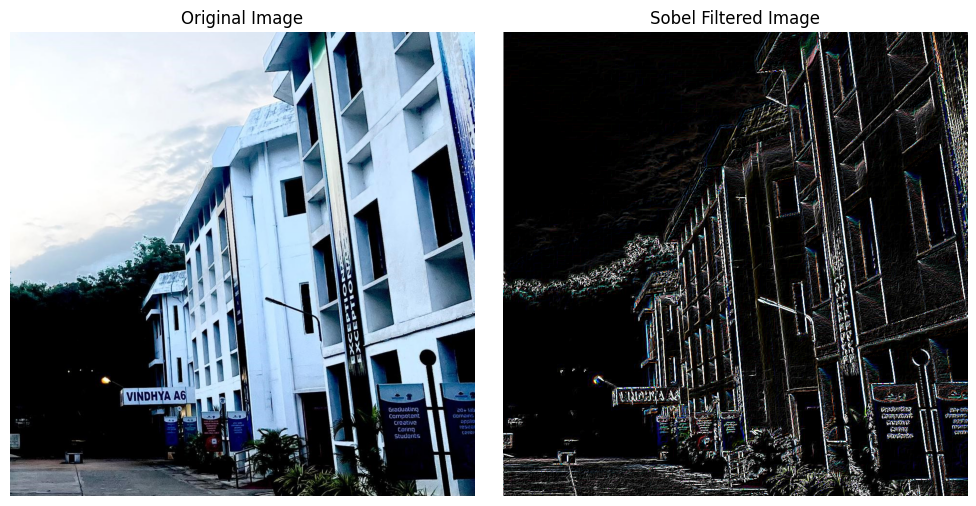

In [156]:
img3 = cv2.imread("../images/IMG3.jpeg")
img3 = img3.astype(np.float32)

img3_sobel = sobelFilter(img3)
img3_sobel_rgb = cv2.cvtColor(img3_sobel.astype(np.uint8), cv2.COLOR_BGR2RGB)

plt.figure(figsize=(10, 5))
plt.subplot(121)
plt.imshow(cv2.cvtColor(img3.astype(np.uint8), cv2.COLOR_BGR2RGB))
plt.title("Original Image")
plt.axis("off")

plt.subplot(122)
plt.imshow(img3_sobel_rgb)
plt.title("Sobel Filtered Image")
plt.axis("off")

plt.tight_layout()
plt.show()


#### 3.2 Write a function `prewittFilter(img)` that applies the Prewitt filter to IMG3 . The function should calculate the gradient in the horizontal and vertical directions using Prewitt kernels and combine them to get the edge magnitude

In [13]:

def prewittFilterX(img):
    kernel = np.array([[-1, 0, 1], [-1, 0, 1], [-1, 0, 1]])
    res= conv2D(img, kernel)
    return np.clip(res, 0, 255)

def prewittFilterY(img):
    kernel = np.array([[-1, -1, -1], [0, 0, 0], [1, 1, 1]])
    res= conv2D(img, kernel)
    return np.clip(res, 0, 255)

def prewittFilter(img):
    img_prewittX = prewittFilterX(img)
    img_prewittY = prewittFilterY(img)

    return np.sqrt(img_prewittX**2 + img_prewittY**2)

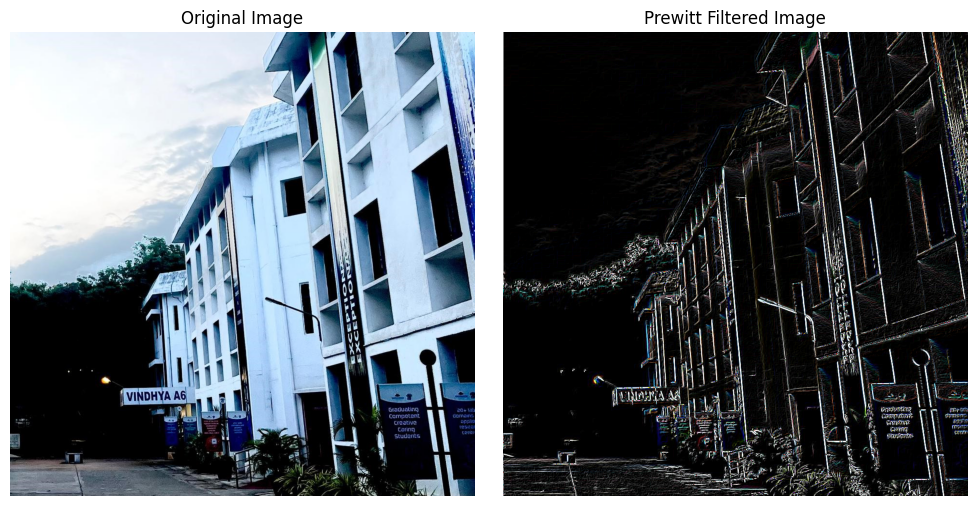

In [91]:

img3_prewitt = prewittFilter(img3)
img3_prewitt_rgb = cv2.cvtColor(img3_prewitt.astype(np.uint8), cv2.COLOR_BGR2RGB)

plt.figure(figsize=(10, 5))
plt.subplot(121)
plt.imshow(cv2.cvtColor(img3.astype(np.uint8), cv2.COLOR_BGR2RGB))
plt.title("Original Image")
plt.axis("off")

plt.subplot(122)
plt.imshow(img3_prewitt_rgb)
plt.title("Prewitt Filtered Image")
plt.axis("off")

plt.tight_layout()
plt.show()


#### 3.3 Write a function `robertsFilter(img)` that applies the Roberts cross operator to IMG3 . The function should compute the gradient magnitude using the Roberts kernels and return the edge map.


In [14]:
def robertsFilterX(img):
    kernel = np.array([[1, 0], [0, -1]])
    res= conv2D(img, kernel)
    return np.clip(res, 0, 255)


def robertsFilterY(img):
    kernel = np.array([[0, 1], [-1, 0]])
    res= conv2D(img, kernel)
    return np.clip(res, 0, 255)


def robertsFilter(img):
    img_robertsX = robertsFilterX(img)
    img_robertsY = robertsFilterY(img)

    return np.sqrt(img_robertsX**2 + img_robertsY**2)

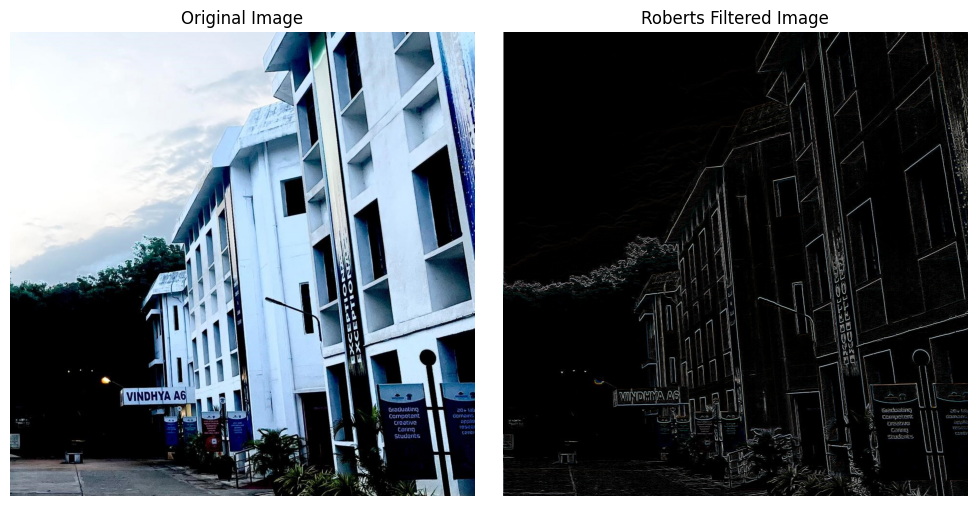

In [89]:

img3_roberts = robertsFilter(img3)
img3_roberts_rgb = cv2.cvtColor(img3_roberts.astype(np.uint8), cv2.COLOR_BGR2RGB)

plt.figure(figsize=(10, 5))

plt.subplot(121)
plt.imshow(cv2.cvtColor(img3.astype(np.uint8), cv2.COLOR_BGR2RGB))
plt.title("Original Image")
plt.axis("off")

plt.subplot(122)
plt.imshow(img3_roberts_rgb)
plt.title("Roberts Filtered Image")
plt.axis("off")

plt.tight_layout()
plt.show()

#### 3.4 Make 3 subplots corresponding to the X gradient, Y gradient and the Edge Map for each of the filters.


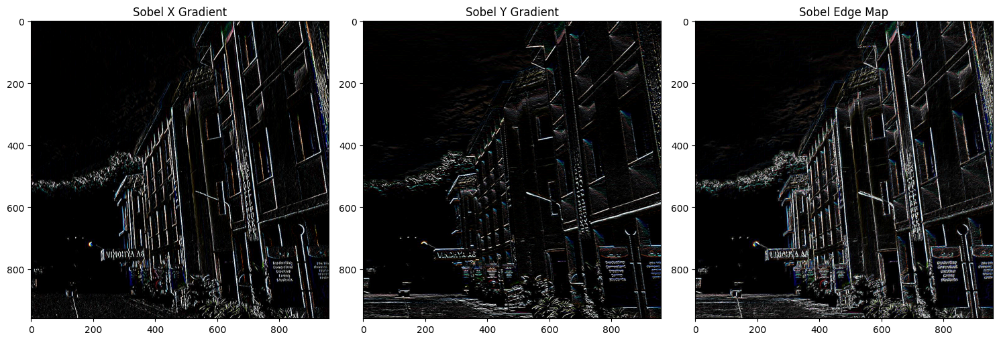

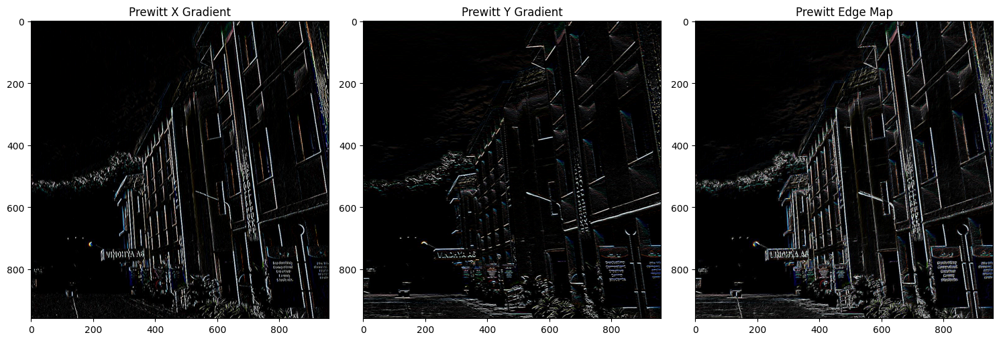

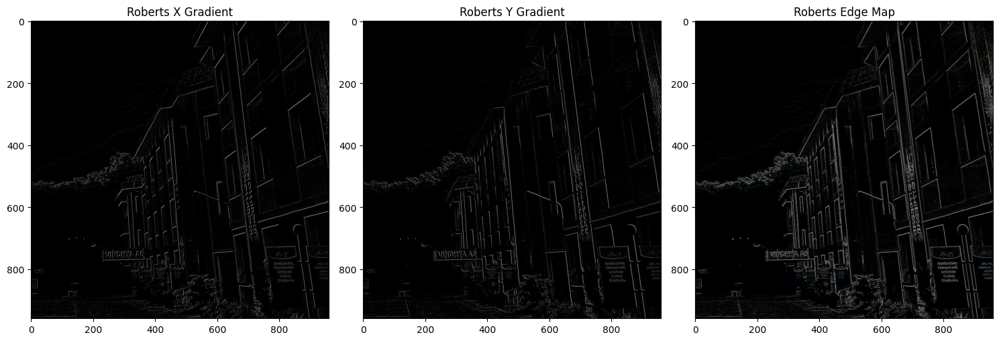

In [94]:

img3_sobelX = sobelFilterX(img3)
img3_sobelY = sobelFilterY(img3)

img3_sobelX_rgb = cv2.cvtColor(img3_sobelX.astype(np.uint8), cv2.COLOR_BGR2RGB)
img3_sobelY_rgb = cv2.cvtColor(img3_sobelY.astype(np.uint8), cv2.COLOR_BGR2RGB)

plt.figure(figsize=(15, 5))

plt.subplot(131)
plt.imshow(img3_sobelX_rgb)
plt.title("Sobel X Gradient")

plt.subplot(132)
plt.imshow(img3_sobelY_rgb)
plt.title("Sobel Y Gradient")

plt.subplot(133)
plt.imshow(img3_sobel_rgb)
plt.title("Sobel Edge Map")

plt.tight_layout()
plt.show()

img3_prewittX = prewittFilterX(img3)
img3_prewittY = prewittFilterY(img3)

img3_prewittX_rgb = cv2.cvtColor(img3_prewittX.astype(np.uint8), cv2.COLOR_BGR2RGB)
img3_prewittY_rgb = cv2.cvtColor(img3_prewittY.astype(np.uint8), cv2.COLOR_BGR2RGB)

plt.figure(figsize=(15, 5))

plt.subplot(131)
plt.imshow(img3_prewittX_rgb)
plt.title("Prewitt X Gradient")

plt.subplot(132)
plt.imshow(img3_prewittY_rgb)
plt.title("Prewitt Y Gradient")

plt.subplot(133)
plt.imshow(img3_prewitt_rgb)
plt.title("Prewitt Edge Map")

plt.tight_layout()
plt.show()

img3_robertsX = robertsFilterX(img3)
img3_robertsY = robertsFilterY(img3)

img3_robertsX_rgb = cv2.cvtColor(img3_robertsX.astype(np.uint8), cv2.COLOR_BGR2RGB)
img3_robertsY_rgb = cv2.cvtColor(img3_robertsY.astype(np.uint8), cv2.COLOR_BGR2RGB)

plt.figure(figsize=(15, 5))

plt.subplot(131)
plt.imshow(img3_robertsX_rgb)
plt.title("Roberts X Gradient")

plt.subplot(132)
plt.imshow(img3_robertsY_rgb)
plt.title("Roberts Y Gradient")

plt.subplot(133)
plt.imshow(img3_roberts_rgb)
plt.title("Roberts Edge Map")

plt.tight_layout()
plt.show()

#### 3.5 Apply a Laplacian filter on IMG3 by writing a function `laplacianFilter(img, k)` that takes in a 2D image, kernel size and applies the Laplacian filter. Vary the kernel(k=any 3 values) size and comment on the effects

In [157]:
def laplacianFilter(img, k):

    pad = k // 2

    kernel = np.ones((k, k)) * -1
    kernel[pad, pad] = k * k - 1

    res = conv2D(img, kernel)
    res=np.clip(res, 0, 255)

    return res, kernel

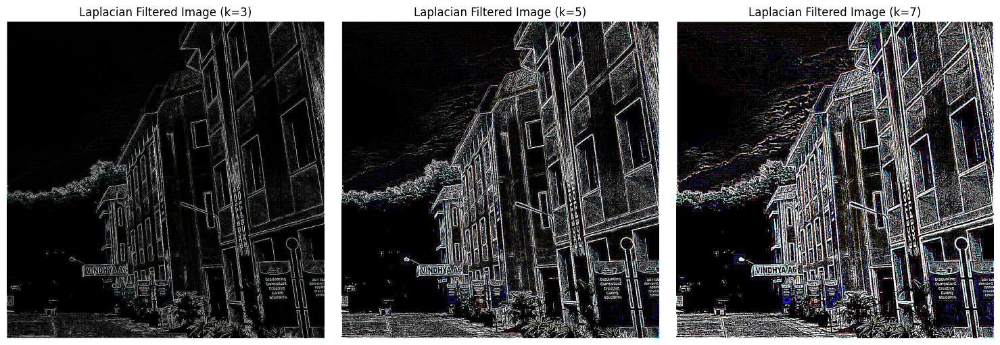

In [158]:
k_values = [3, 5, 7]

fig, axes = plt.subplots(1, len(k_values), figsize=(15, 5))

for i, k in enumerate(k_values):
    img3_laplacian, _ = laplacianFilter(img3, k)
    img3_laplacian_rgb = cv2.cvtColor(img3_laplacian.astype(np.uint8), cv2.COLOR_BGR2RGB)

    axes[i].imshow(img3_laplacian_rgb)
    axes[i].set_title(f"Laplacian Filtered Image (k={k})")
    axes[i].axis("off")

plt.tight_layout()
plt.show()

Observations

- As kernel size increases, the filter captures progressively finer details and textures. This is evident in the increasing visibility of architectural features, foliage textures, and small objects in the scene.
- Larger kernels produce thicker edge lines. This can be beneficial for emphasizing edges but may lead to loss of precision in edge localization.
- The larger the kernel, the more sensitive the filter becomes to noise. This is clearly visible in the $k=7$ image, where there's significant speckling, especially in areas that should be relatively uniform.
- Larger kernels tend to enhance the contrast of detected edges, making them stand out more against the background. This is particularly noticeable in how the building outlines become more prominent from $k=3$ to $k=7$.


#### 3.6 Analyze and comment on which types of edges are best identified by each of the filters.

- Sobel and Prewitt are most effective for detecting strong structural edges and are less sensitive to noise.
- Roberts is best for diagonal edges and sharp transitions but misses some finer details.
- Laplacian provides the most comprehensive edge detection, capturing edges in all directions. It's particularly good at revealing fine textures and details, especially with larger kernel sizes, but at the cost of increased noise sensitivity.

---

## 4. Sharpen Up

#### 4.1 Write a function `unsharpMask(img, k, sigma)` that takes in a 2D image, a kernel size $k$, and a standard deviation $\sigma$, and applies the unsharp masking technique. Apply this function to IMG4 .

In [9]:
def unsharpMask(img, k, sigma):

    img_gaussian, _ = gaussianFilter(img, k, sigma)
    detail = img - img_gaussian

    sharpened = img + detail

    return np.clip(sharpened, 0, 255)

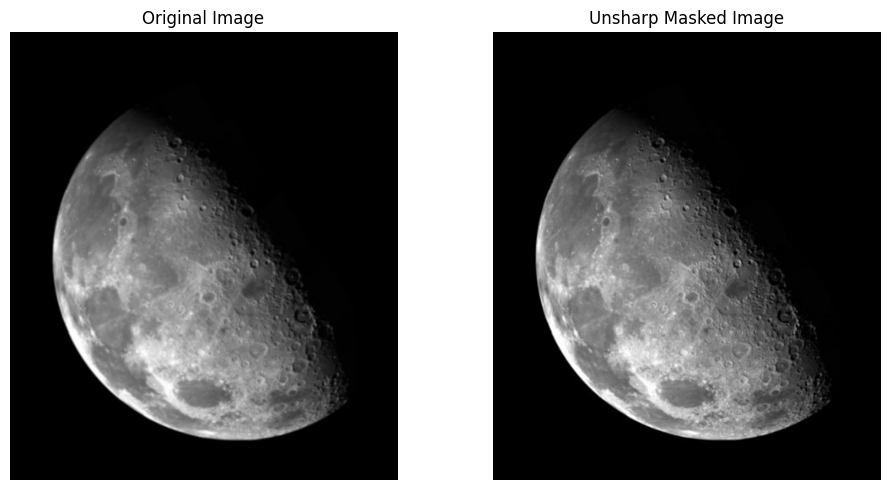

In [102]:
img4 = cv2.imread("../images/IMG4.png")
img4 = img4.astype(np.float32)

img4_unsharpMasked = unsharpMask(img4, 3, 1)
img4_unsharpMasked_rgb = cv2.cvtColor(img4_unsharpMasked.astype(np.uint8), cv2.COLOR_BGR2RGB)

plt.figure(figsize=(10, 5))

plt.subplot(121)
plt.imshow(cv2.cvtColor(img4.astype(np.uint8), cv2.COLOR_BGR2RGB))
plt.title("Original Image")
plt.axis("off")

plt.subplot(122)
plt.imshow(img4_unsharpMasked_rgb)
plt.title("Unsharp Masked Image")
plt.axis("off")

plt.tight_layout()
plt.show()

#### 4.2 Vary the kernel size k(for any 3 values) and the standard deviation σ in unsharpMask(img, k, sigma) and comment on how these parameters affect the sharpness of the image.


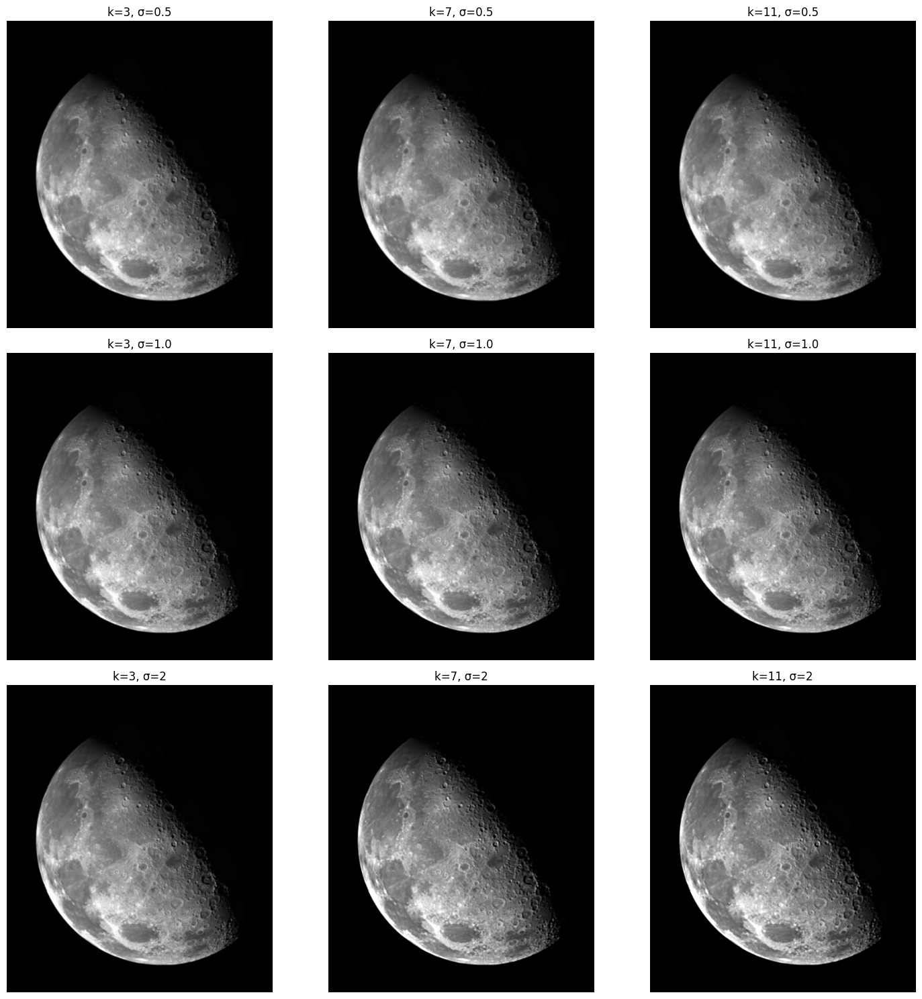

In [103]:
k_values = [3, 7, 11]
sigma_values = [0.5, 1.0, 2]

nrows = len(sigma_values)
ncols = len(k_values)

plt.figure(figsize=(15, nrows * 5))

for i, sigma in enumerate(sigma_values):
    for j, k in enumerate(k_values):
        img4_unsharpMasked = unsharpMask(img4, k, sigma)
        img4_unsharpMasked_rgb = cv2.cvtColor(img4_unsharpMasked.astype(np.uint8), cv2.COLOR_BGR2RGB)

        plt.subplot(nrows, ncols, i * ncols + j + 1)
        plt.imshow(img4_unsharpMasked_rgb)
        plt.axis("off")
        plt.title(f"k={k}, σ={sigma}")

plt.tight_layout()
plt.show()

Observations

- As kernel size increases, the sharpening effect becomes more pronounced. This is because larger kernels capture more of the surrounding pixel values, leading to a stronger contrast boost.
- As $\sigma$ increases, the sharpening effect becomes more pronounced.

#### 4.3 Write a function `highboostFilter(img, k, sigma, A)` that applies highboost filtering to IMG4. The function should take in a 2D image, a kernel size $k$, a standard deviation $\sigma$, and a boost factor $A$. Apply the function with different values of $A$(for any 3 values), comment on the role of $A$ and compare the results

In [27]:
def highboostFilter(img, k, sigma, A):

    img_gaussian, _ = gaussianFilter(img, k, sigma)
    detail = img - img_gaussian

    sharpened = img + A * detail

    return np.clip(sharpened, 0, 255)

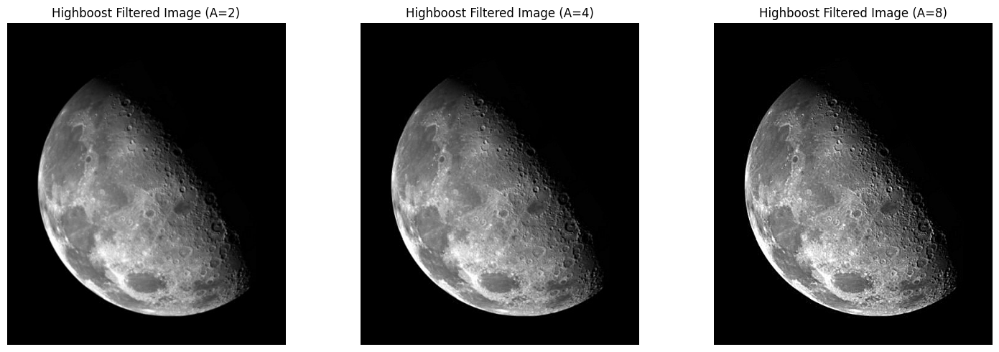

In [106]:

A_values = [2, 4, 8]

k=5
sigma=0.6

fig, axes = plt.subplots(1, len(A_values), figsize=(15, 5))

for i, A in enumerate(A_values):
    img4_highboost = highboostFilter(img4, k, sigma, A)
    img4_highboost_rgb = cv2.cvtColor(img4_highboost.astype(np.uint8), cv2.COLOR_BGR2RGB)

    axes[i].imshow(img4_highboost_rgb)
    axes[i].set_title(f"Highboost Filtered Image (A={A})")
    axes[i].axis("off")

plt.tight_layout()
plt.show()


Observations

The highboost filter is a generalization of the unsharp masking technique, where $A$ controls the strength of the sharpening effect. Higher values of $A$ lead to more pronounced sharpening, while lower values produce a subtler effect.

#### 4.4 Make 3 subplots showing the original image, the unsharp masked image, and the highboost filtered image. Which method provides better results for enhancing fine details?

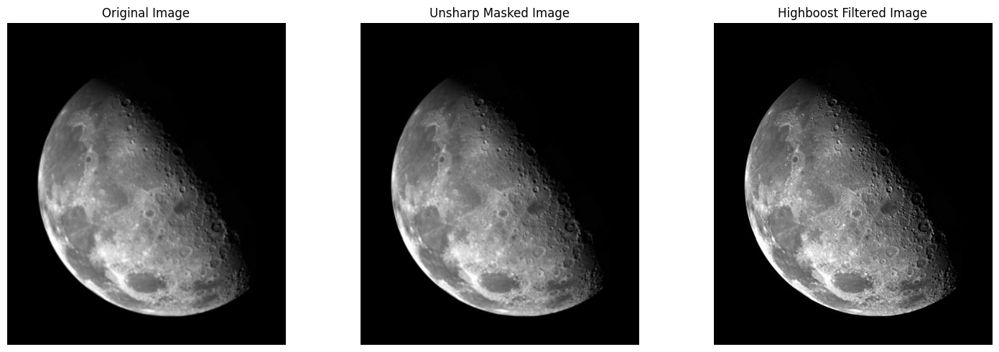

In [107]:

img4_unsharpMasked = unsharpMask(img4, 5, 0.6)
img4_highboost = highboostFilter(img4, 5, 0.6, 4)

plt.figure(figsize=(15, 5))

plt.subplot(131)
plt.imshow(cv2.cvtColor(img4.astype(np.uint8), cv2.COLOR_BGR2RGB))
plt.title("Original Image")
plt.axis("off")

plt.subplot(132)
plt.imshow(cv2.cvtColor(img4_unsharpMasked.astype(np.uint8), cv2.COLOR_BGR2RGB))
plt.title("Unsharp Masked Image")
plt.axis("off")

plt.subplot(133)
plt.imshow(cv2.cvtColor(img4_highboost.astype(np.uint8), cv2.COLOR_BGR2RGB))
plt.title("Highboost Filtered Image")
plt.axis("off")

plt.tight_layout()
plt.show()

Observations

Highboost filtering provides better results than unsharp masking for enhancing fine details. This is because highboost filtering allows for more control over the sharpening effect, making it easier to fine-tune the enhancement to suit the image content.

---

## 5. Rain Rain Go Away!

#### 5.1 Here we are yet again where the rainy forecast is spoiling a IIIT event :(. Use your newfound powers of filtering and convolution to remove the rain in IMG5 so that the event can happen :). Use your functions for mean, median, gaussian and bilateral filtering and report and display the best parameters for each of the 4 methods. Also, add your observations on the performance of each of the methods, which seems to be the best and why?

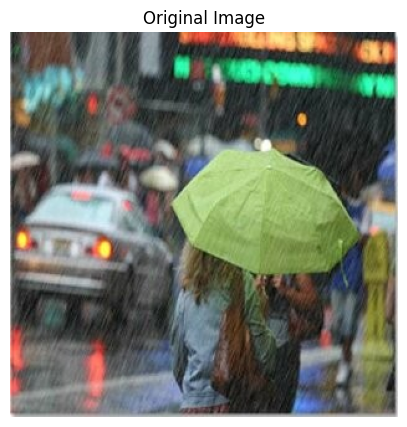

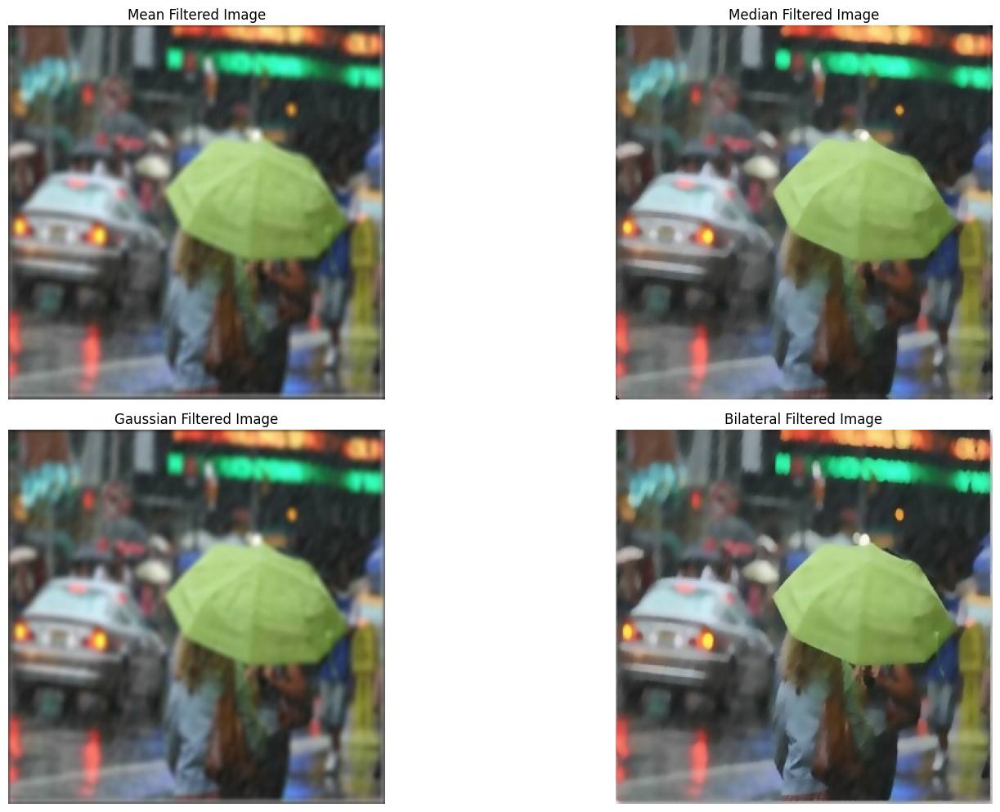

In [123]:

img5 = cv2.imread("../images/IMG5.jpg")
img5 = img5.astype(np.float32)


plt.figure(figsize=(5, 5))
plt.imshow(cv2.cvtColor(img5.astype(np.uint8), cv2.COLOR_BGR2RGB))
plt.title("Original Image")
plt.axis("off")

img5_meanFiltered = fastMeanFilter(img5, 7)
img5_medianFiltered = medianFilter(img5, 7)
img5_gaussianFiltered, _ = gaussianFilter(img5, 7, 2)
img5_bilateralFiltered = bilateralFilter(img5, 7, 15, 50)


img5_rgb = cv2.cvtColor(img5.astype(np.uint8), cv2.COLOR_BGR2RGB)
img5_meanFiltered_rgb = cv2.cvtColor(img5_meanFiltered.astype(np.uint8), cv2.COLOR_BGR2RGB)
img5_medianFiltered_rgb = cv2.cvtColor(img5_medianFiltered.astype(np.uint8), cv2.COLOR_BGR2RGB)
img5_gaussianFiltered_rgb = cv2.cvtColor(img5_gaussianFiltered.astype(np.uint8), cv2.COLOR_BGR2RGB)
img5_bilateralFiltered_rgb = cv2.cvtColor(img5_bilateralFiltered, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(15, 15))


plt.subplot(321)
plt.imshow(img5_meanFiltered_rgb)
plt.title("Mean Filtered Image")
plt.axis("off")

plt.subplot(322)
plt.imshow(img5_medianFiltered_rgb)
plt.title("Median Filtered Image")
plt.axis("off")

plt.subplot(323)
plt.imshow(img5_gaussianFiltered_rgb)
plt.title("Gaussian Filtered Image")
plt.axis("off")

plt.subplot(324)
plt.imshow(img5_bilateralFiltered_rgb)
plt.title("Bilateral Filtered Image")
plt.axis("off")

plt.tight_layout()
plt.show()


Observations

- The bilateral filter is the most effective at removing rain streaks while preserving image details. It provides a good balance between noise reduction and edge preservation, resulting in a clean, visually appealing image. Median filtering is also effective at removing rain streaks, but it tends to blur the image slightly more than the bilateral filter. 

- The Gaussian filter is less effective at removing rain streaks, as it tends to blur the image more than the previous filters. 

- The mean filter is the least effective at removing rain streaks, as it blurs the image significantly and results in a loss of fine details and textures.

#### 5.2 You are given IMG6 , but it is not clear. What type of noise is there in IMG6 ? What is the best filtering method to remove it? Display your results when using this method to remove the noise in IMG6.

The noise present is called salt and pepper noise. The best filtering method to remove it is median filtering.

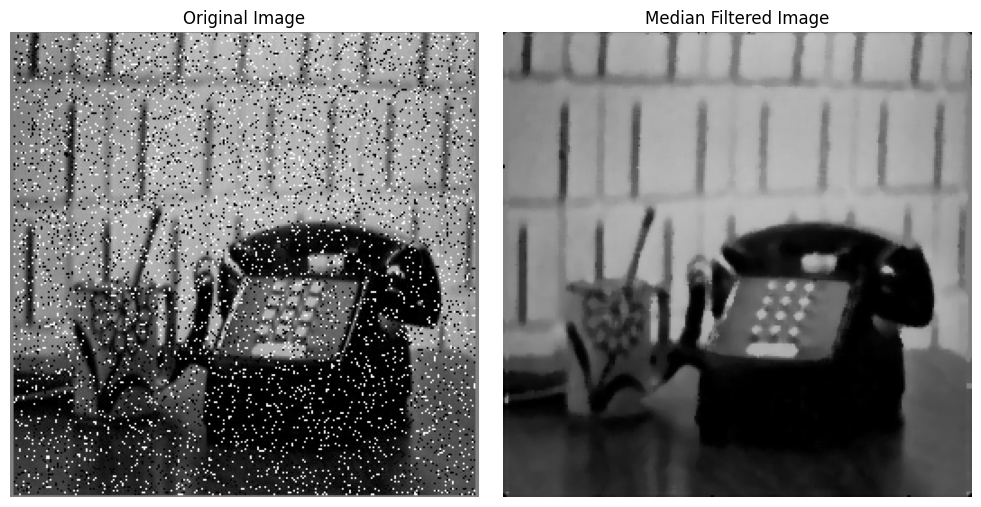

In [129]:

img6 = cv2.imread("../images/IMG6.png")
img6.astype(np.float32)

img6_medianFiltered = medianFilter(img6, 5)
img6_medianFiltered_rgb = cv2.cvtColor(img6_medianFiltered.astype(np.uint8), cv2.COLOR_BGR2RGB)

plt.figure(figsize=(10, 5))

plt.subplot(121)
plt.imshow(cv2.cvtColor(img6.astype(np.uint8), cv2.COLOR_BGR2RGB))
plt.title("Original Image")
plt.axis("off")

plt.subplot(122)
plt.imshow(img6_medianFiltered_rgb)
plt.title("Median Filtered Image")
plt.axis("off")

plt.tight_layout()
plt.show()

---

## 6. Transform and Conquer

#### 6a.1 Given an image, IMG7 , of overlapping coins in a cash sorting system, develop an image processing pipeline to separate each coin for accurate classification. The resulting image should be as shown in Target IMG7 . Use morphological operations you deem suitable (functions should be written on your own). Explain the steps taken. Hint: You can use different kernel shape to achieve a closer match.

In [85]:

def erosion(img, kernel):
    h, w, c = img.shape
    k, _ = kernel.shape
    pad = k // 2

    padded_img = np.pad(img, ((pad, pad), (pad, pad), (0, 0)), mode="constant", constant_values=255)
    new_img = np.zeros((h, w, c))

    for ch in range(c):
        for i in range(h):
            for j in range(w):
                region = padded_img[i : i + k, j : j + k, ch]
                new_img[i, j, ch] = np.min(region * kernel)

    return new_img

def dilation(img, kernel):
    h, w, c = img.shape
    k, _ = kernel.shape
    pad = k // 2

    padded_img = np.pad(img, ((pad, pad), (pad, pad), (0, 0)), mode="constant", constant_values=0)
    new_img = np.zeros((h, w, c))

    for ch in range(c):
        for i in range(h):
            for j in range(w):
                region = padded_img[i : i + k, j : j + k, ch]
                new_img[i, j, ch] = np.max(region * kernel)

    return new_img


def opening(img, kernel_erode, kernel_dilate):
    return dilation(erosion(img, kernel_erode), kernel_dilate)



In [22]:
def create_circular_kernel(size):
    assert size % 2 == 1, "Size must be odd for a symmetrical kernel."
    r = size // 2
    y, x = np.ogrid[-r:r+1, -r:r+1]
    mask = x**2 + y**2 <= r**2
    kernel = np.zeros((size, size), dtype=np.uint8)
    kernel[mask] = 1
    return kernel

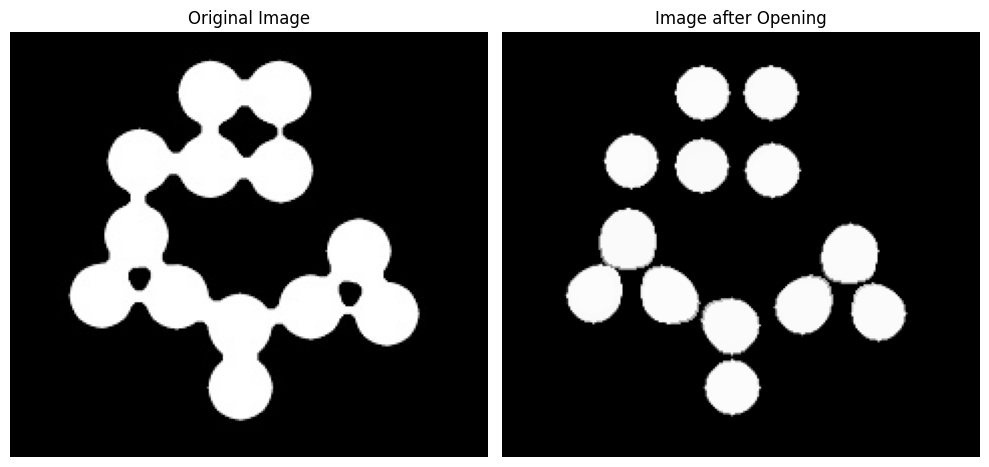

In [187]:
img7 = cv2.imread("../images/IMG7.jpg")
img7 = img7.astype(np.float32)

kernel_size = 19
kernel_erode = np.ones((kernel_size, kernel_size))

kernel_size = 21
kernel_dilate = create_circular_kernel(kernel_size)

img7_opening = opening(img7, kernel_erode, kernel_dilate)
img7_opening_rgb = cv2.cvtColor(img7_opening.astype(np.uint8), cv2.COLOR_BGR2RGB)


plt.figure(figsize=(10, 5))

plt.subplot(121)
plt.imshow(cv2.cvtColor(img7.astype(np.uint8), cv2.COLOR_BGR2RGB))
plt.title("Original Image")
plt.axis("off")

plt.subplot(122)
plt.imshow(img7_opening_rgb)
plt.title("Image after Opening")
plt.axis("off")

plt.tight_layout()
plt.show()


Steps taken to separate each coin:

Used morphological operations, namely opening i.e. erosion followed by dilation, to separate each coin. The opening operation helps to remove small noise and separate the coins by breaking the connections between them. The structuring element used for the erosion is a square kernel of size 19x19, and the structuring element used for the dilation is a circular disk kernel of size 21x21.

### Signature Verification

#### 6b.1 Download any 2 authentic and any 2 fraud signatures corresponding to a certain person from CEDAR-Dataset(https://www.kaggle.com/datasets/shreelakshmigp/cedardataset).


In [159]:
authentic_1 = cv2.imread("../images/signatures/original_10_1.png")
authentic_2 = cv2.imread("../images/signatures/original_10_2.png")

forged_1 = cv2.imread("../images/signatures/forgeries_10_1.png")
forged_2 = cv2.imread("../images/signatures/forgeries_10_2.png")

authentic_1 = cv2.cvtColor(authentic_1, cv2.COLOR_BGR2GRAY)
authentic_2 = cv2.cvtColor(authentic_2, cv2.COLOR_BGR2GRAY)
forged_1 = cv2.cvtColor(forged_1, cv2.COLOR_BGR2GRAY)
forged_2 = cv2.cvtColor(forged_2, cv2.COLOR_BGR2GRAY)


#### 6b.2 Find skeleton of each of the signatures, using your own function, and comment on the stability of this feature across various signatures of a particular person. Hint: Mirror the process of skeletonize (https://scikit-image.org/docs/stable/auto_examples/edges/plot_skeleton.html) in your function.

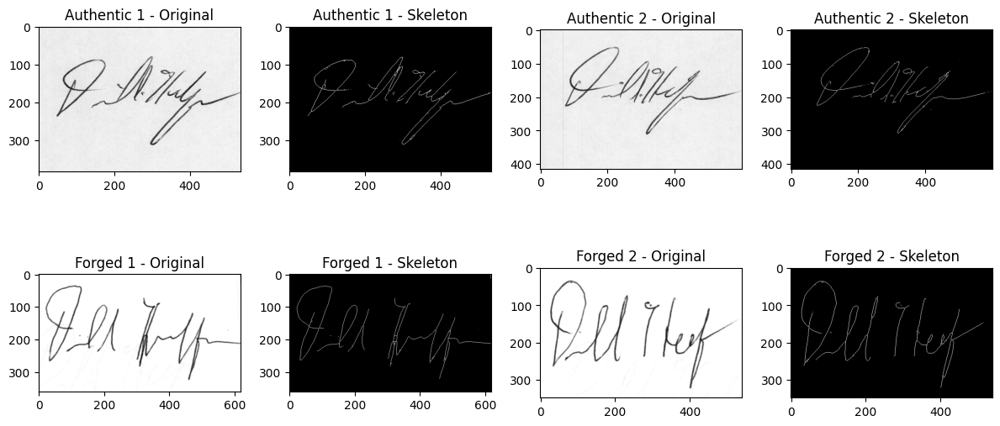

In [160]:

# Convert to binary by thresholding
_, auth1_binary = cv2.threshold(authentic_1, 200, 255, cv2.THRESH_BINARY_INV)
_, auth2_binary = cv2.threshold(authentic_2, 200, 255, cv2.THRESH_BINARY_INV)
_, forged1_binary = cv2.threshold(forged_1, 200, 255, cv2.THRESH_BINARY_INV)
_, forged2_binary = cv2.threshold(forged_2, 200, 255, cv2.THRESH_BINARY_INV)

# Normalize to range [0, 1]
auth1_binary = auth1_binary // 255
auth2_binary = auth2_binary // 255
forged1_binary = forged1_binary // 255
forged2_binary = forged2_binary // 255

# skeletonization
auth1_skeleton = skeletonize(auth1_binary)
auth2_skeleton = skeletonize(auth2_binary)
forged1_skeleton = skeletonize(forged1_binary)
forged2_skeleton = skeletonize(forged2_binary)



fig, ax = plt.subplots(2, 4, figsize=(12, 6))

ax[0, 0].imshow(authentic_1, cmap='gray')
ax[0, 0].set_title("Authentic 1 - Original")
ax[0, 1].imshow(auth1_skeleton, cmap='gray')
ax[0, 1].set_title("Authentic 1 - Skeleton")

ax[0, 2].imshow(authentic_2, cmap='gray')
ax[0, 2].set_title("Authentic 2 - Original")
ax[0, 3].imshow(auth2_skeleton, cmap='gray')
ax[0, 3].set_title("Authentic 2 - Skeleton")

ax[1, 0].imshow(forged_1, cmap='gray')
ax[1, 0].set_title("Forged 1 - Original")
ax[1, 1].imshow(forged1_skeleton, cmap='gray')
ax[1, 1].set_title("Forged 1 - Skeleton")

ax[1, 2].imshow(forged_2, cmap='gray')
ax[1, 2].set_title("Forged 2 - Original")
ax[1, 3].imshow(forged2_skeleton, cmap='gray')
ax[1, 3].set_title("Forged 2 - Skeleton")

plt.tight_layout()
plt.show()



Stability of feature

The skeleton feature is stable across various signatures of a particular person. The skeleton provides a simplified representation of the signature, capturing the main structure and shape of the signature. The skeleton is invariant to small variations in the signature, such as pen pressure, stroke thickness, and minor distortions. This makes it a robust feature for signature verification, as it focuses on the essential characteristics of the signature while ignoring minor details.

Here, we can see that the skeleton of the authentic signatures is consistent and captures the main structure of the signature. The skeleton of the fraud signatures, on the other hand, seems more inconsistent and disoriented, indicating that the signatures are not genuine.

---

## 7. Body Scan Enhancement

#### 7.1 IMG8 is a nuclear whole body bone scan, used to detect diseases such as bone infection and tumors. Your objective is to enhance this image by sharpening it and by bringing out more of the skeletal detail as can be seen in Enhanced IMG8 . Use functions written so far (and more) to achieve the above, elaborate on the steps involved.

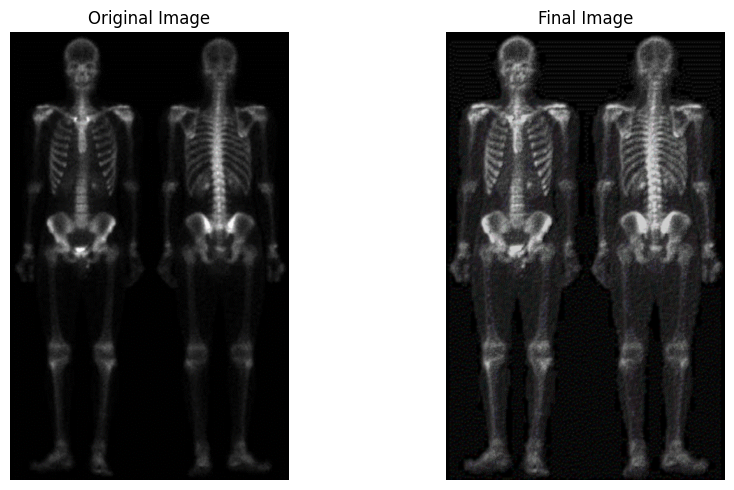

In [79]:

img8 = cv2.imread("../images/IMG8.png")
img8 = cv2.cvtColor(img8, cv2.COLOR_BGR2RGB)
img8 = img8.astype(np.float32)

# unsharp masking 
img8_unsharpMasked = unsharpMask(img8, 5, 5)
img8_unsharpMasked = img8_unsharpMasked.astype(np.float32)

# sobel edge detection
img8_sobel = sobelFilter(img8)

# smoothing the sobel image
img8_sobel_gaussian, _ = gaussianFilter(img8_sobel, 5, 1.5)
img8_sobel_gaussian = img8_sobel_gaussian.astype(np.float32)

# sharpening
img8_sharpened = img8_unsharpMasked + img8_sobel_gaussian
img8_sharpened = np.clip(img8_sharpened, 0, 255)
img8_sharpened = img8_sharpened.astype(np.uint8)

# further sharpening
img8_sharpened_further = img8_sharpened + img8_sobel_gaussian
img8_sharpened_further = np.clip(img8_sharpened_further, 0, 255)

# power law transformation
gamma = 0.75
img8_final = 1.8*np.power(img8_sharpened, gamma)
img8_final = np.clip(img8_final, 0, 255)

# brightness increase
img8_final = img8_final * 1.8
img8_final = np.clip(img8_final, 0, 255)



plt.figure(figsize=(10, 5))

plt.subplot(121)
plt.imshow(img8.astype(np.uint8))
plt.title("Original Image")
plt.axis("off")

plt.subplot(122)
plt.imshow(img8_final.astype(np.uint8))
plt.title("Final Image")
plt.axis("off")

plt.tight_layout()
plt.show()



Explanation

The steps used to enhance the nuclear whole-body scan image are as follows:

1. Unsharp Masking: The image was sharpened using an unsharp mask with a kernel size of 5 and an amount of 5, enhancing the finer details.
   
2. Sobel Edge Detection: Sobel filtering was applied to detect the edges in the image, emphasizing transitions and contours.

3. Gaussian Smoothing: The Sobel-filtered image was smoothed using a Gaussian filter with a kernel size of 5 and $\sigma$ of 1.5 to reduce noise and smooth the edges.

4. Initial Sharpening: The unsharp-masked image was combined with the smoothed Sobel image to further enhance the edges and details.

5. Further Sharpening: An additional sharpening step was performed by combining the already sharpened image with the smoothed Sobel image again, amplifying the edges further.

6. Power-Law Transformation: A gamma correction with a gamma value of 0.75 was applied to improve contrast and brighten the mid-tones, leading to a more dynamic range of intensity values.

7. Brightness Increase: The brightness of the image was increased by multiplying the image intensities by 1.8 to enhance visibility further.


---

## 8. You Can't See Me

#### 8.1 You have been given an image IMG9 which is corrupted. Apply various methods learned so far to obtain the clean version (as close as you can get!). Explain your process and reasoning.

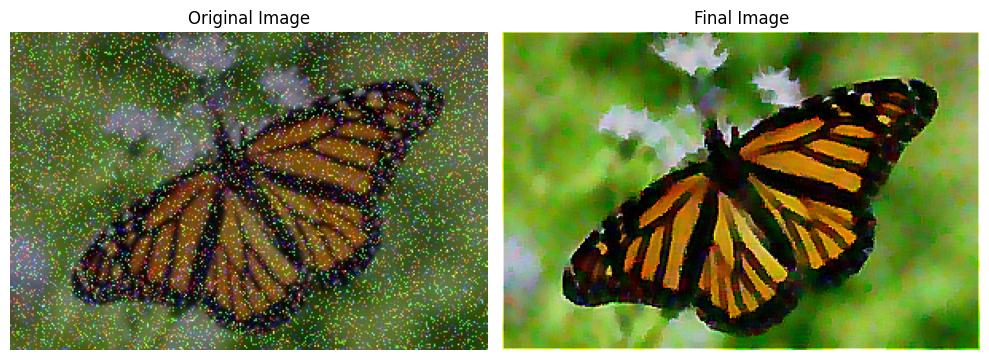

In [119]:
img9 = cv2.imread("../images/IMG9.jpg")
img9 = cv2.cvtColor(img9, cv2.COLOR_BGR2RGB)

# erosion
kernel_size = 3
kernel_erode = np.ones((kernel_size, kernel_size))
img9_eroded = erosion(img9, kernel_erode)

# bilateral filter
img9_bilateralFiltered = bilateralFilter(img9_eroded, 7, 20, 30)

# brightness increase
img9_bilateralFiltered = img9_bilateralFiltered * 1.75
img9_bilateralFiltered = np.clip(img9_bilateralFiltered, 0, 255)

# highboost filter
img9_highboost = highboostFilter(img9_bilateralFiltered, 3, 1.5, 5)




plt.figure(figsize=(10, 5))

plt.subplot(121)
plt.imshow(img9)
plt.title("Original Image")
plt.axis("off")

plt.subplot(122)
plt.imshow(img9_highboost.astype(np.uint8))
plt.title("Final Image")
plt.axis("off")

plt.tight_layout()
plt.show()

Process

The image was cleaned through the following steps:

1. Erosion: The image was corrupted, containing noise and irregularities. Erosion was applied using a kernel size of 3x3, which helped remove these small, isolated imperfections by shrinking the bright areas of the image, effectively cleaning up noise.

2. Bilateral Filtering: After erosion, a bilateral filter was applied to preserve edges while reducing the remaining noise. The bilateral filter was configured with a kernel size of 7, a $\sigma$ range of 20 (for intensity), and 30 (for spatial proximity). This filtering step smoothened out noise while preserving important edges and details, ensuring that key structures in the image (like contours) were retained.

3. Brightness Enhancement: After filtering, the brightness was increased by multiplying the pixel values by 1.75. The brightness adjustment improved the overall visibility and contrast of the image.

4. Highboost Filtering: To further sharpen and enhance important features, a highboost filter was applied with parameters designed to amplify the high-frequency components of the image (edges and fine details) while still preserving the low-frequency (smooth areas). The highboost filter enhanced edges, making the cleaned image appear sharper and more detailed.

This process resulted in a much cleaner and sharper version of the original corrupted image.


---